In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from numpy.matlib import repmat
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix

## K-Means Clustering on Dataset with All Variables (11 dimensions)

In [2]:
# Reads the reduced csv file
#df = pd.read_csv('winequality-red_reduced.csv').iloc[:,1:] #gets rid of the unneeded 1st column with indexes

# Reads the pca transformed csv file
#df = pd.read_csv('winequality-red_pca.csv').iloc[:,1:] #gets rid of the unneeded 1st column with indexes

# Reads the original csv file
df = pd.read_csv('winequality-red.csv')
df['quality'] = ['high' if i > 6.5 else 'low' for i in df.quality]

# Display dataframe
df

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,low
1,7.8,0.880,0.00,2.6,0.098,25.0,67.0,0.99680,3.20,0.68,9.8,low
2,7.8,0.760,0.04,2.3,0.092,15.0,54.0,0.99700,3.26,0.65,9.8,low
3,11.2,0.280,0.56,1.9,0.075,17.0,60.0,0.99800,3.16,0.58,9.8,low
4,7.4,0.700,0.00,1.9,0.076,11.0,34.0,0.99780,3.51,0.56,9.4,low
...,...,...,...,...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,low
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,low
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,low
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,low


In [3]:
# data = df.iloc[:,:-1].to_numpy()
# data = data[:,[0,1,2,3,4,5]] #This is to individually select certain columns
# data.shape

In [4]:
# kmeans = KMeans(algorithm="full", n_clusters=2).fit(data)

In [5]:
# df['c'] = kmeans.labels_
# sns.pairplot(df.drop('c',axis=1), hue='quality')

In [6]:
# sns.pairplot(df.drop('quality',axis=1), hue='c')

In [7]:
# c_pred = kmeans.labels_
# c_true = (df['quality']=='high').astype(int).to_numpy()
# conf = confusion_matrix(c_true, c_pred)
# pd.DataFrame(conf, index=['truth: low','truth: high'])

In [8]:
# Recall
# conf[1,1]/(conf[1,0]+conf[1,1])

In [9]:
# Specificity
# conf[0,0]/(conf[0,0]+conf[0,1])

## K-Means Clustering on Dataset with Reduced Variables (7 dimensions)

In [10]:
# Reads the reduced csv file
df = pd.read_csv('winequality-red_reduced.csv').iloc[:,1:] #gets rid of the unneeded 1st column with indexes

# Display dataframe
df

,fixed acidity,volatile acidity,citric acid,chlorides,total sulfur dioxide,density,sulphates,quality
0,7.4,0.700,0.00,0.076,34.0,0.99780,0.56,low
1,7.8,0.880,0.00,0.098,67.0,0.99680,0.68,low
2,7.8,0.760,0.04,0.092,54.0,0.99700,0.65,low
3,11.2,0.280,0.56,0.075,60.0,0.99800,0.58,low
4,7.4,0.700,0.00,0.076,34.0,0.99780,0.56,low
...,...,...,...,...,...,...,...,...
1594,6.2,0.600,0.08,0.090,44.0,0.99490,0.58,low
1595,5.9,0.550,0.10,0.062,51.0,0.99512,0.76,low
1596,6.3,0.510,0.13,0.076,40.0,0.99574,0.75,low
1597,5.9,0.645,0.12,0.075,44.0,0.99547,0.71,low


In [11]:
data = df.iloc[:,:-1].to_numpy()
data.shape

(1599, 7)

In [12]:
kmeans = KMeans(algorithm="full", n_clusters=2).fit(data)

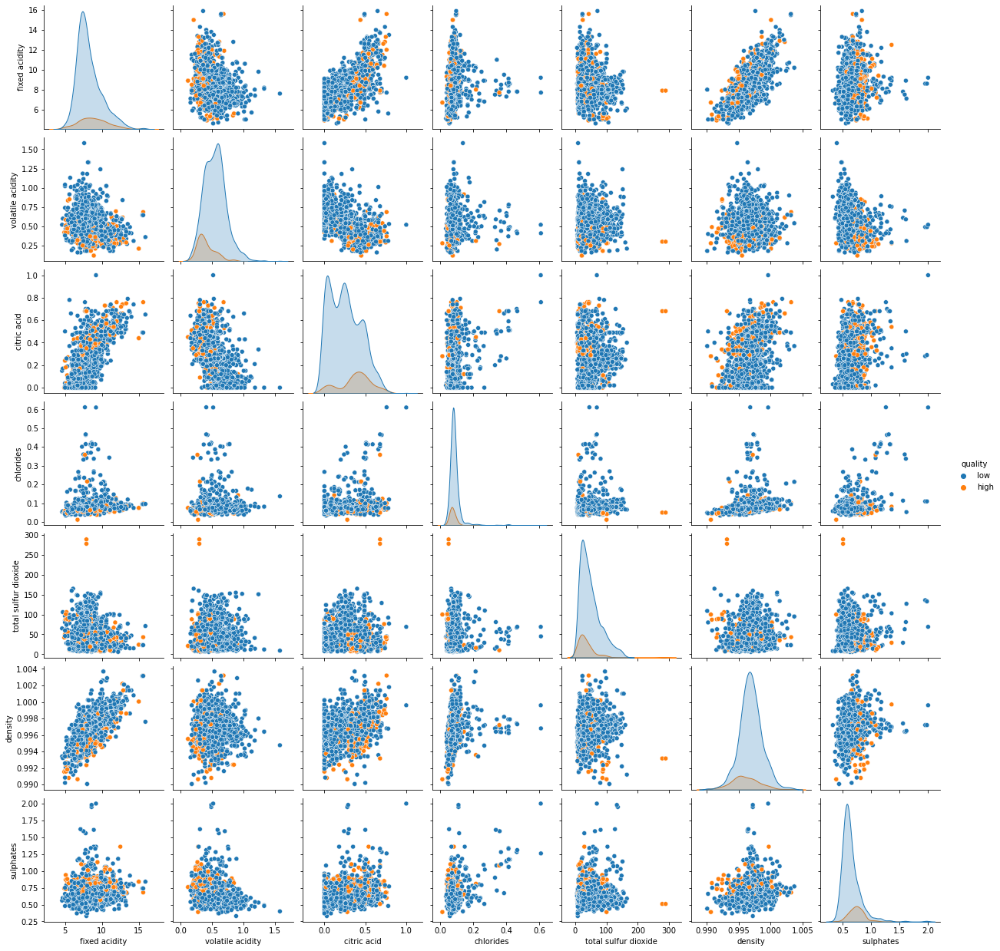

In [13]:
df['c'] = kmeans.labels_
sns.pairplot(df.drop('c',axis=1), hue='quality')

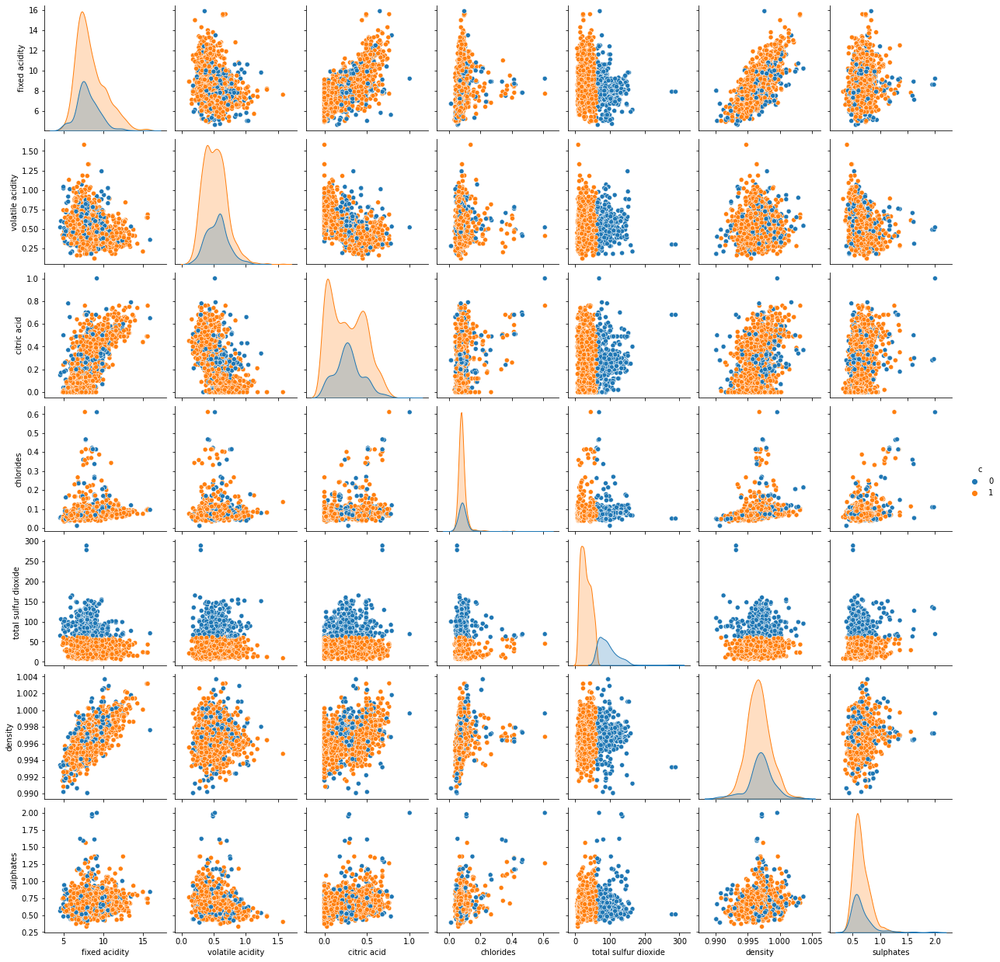

In [14]:
sns.pairplot(df.drop('quality',axis=1), hue='c')

In [15]:
c_pred = kmeans.labels_
c_true = (df['quality']=='high').astype(int).to_numpy()
conf = confusion_matrix(c_true, c_pred)
pd.DataFrame(conf, index=['truth: low','truth: high'])

,0,1
truth: low,384,998
truth: high,23,194


In [16]:
# Recall
conf[1,1]/(conf[1,0]+conf[1,1])

0.8940092165898618

In [17]:
# Specificity
conf[0,0]/(conf[0,0]+conf[0,1])

0.2778581765557164

## K-Means Clustering on PCA Dataset (1st 4 PC's)

In [18]:
# Reads the pca transformed csv file
df = pd.read_csv('winequality-red_pca.csv').iloc[:,1:] #gets rid of the unneeded 1st column with indexes

# Display dataframe
df

,0,1,2,3,4,5,6,7,8,9,10,quality
0,-13.224905,-2.023900,-1.126821,-0.399233,-1.085389,-0.198018,0.031547,-0.147051,0.006047,0.008585,0.000262,low
1,22.037724,4.408322,-0.310378,-0.199938,-0.557109,-0.301325,0.223874,0.143165,-0.089312,-0.015483,0.000243,low
2,7.162673,-2.501461,-0.581868,-0.219069,-0.552934,-0.205114,0.136190,0.058480,-0.084793,-0.005749,0.000346,low
3,13.430063,-1.951122,2.634040,-1.574059,-0.063806,0.089092,-0.218923,-0.062244,0.006281,0.004586,-0.000747,low
4,-13.224905,-2.023900,-1.126821,-0.399233,-1.085389,-0.198018,0.031547,-0.147051,0.006047,0.008585,0.000262,low
...,...,...,...,...,...,...,...,...,...,...,...,...
1594,1.129111,16.313102,-1.860069,-0.257109,-0.200974,-0.058238,-0.020342,0.039370,0.019054,0.008953,-0.000058,low
1595,9.489984,21.627525,-1.986558,-0.027199,0.443711,0.040335,0.102762,-0.015382,0.031433,-0.025658,0.000546,low
1596,-3.431354,14.271243,-1.750719,0.174652,0.236271,0.089513,0.078622,0.026835,-0.020558,-0.016826,0.001028,low
1597,1.132878,16.316167,-2.134414,-0.235388,-0.519028,0.015548,0.094561,-0.041732,0.128439,-0.023328,-0.000269,low


In [19]:
data = df.iloc[:,:-1].to_numpy()
data = data[:,[0,1,2,3]] #Select just the first 4 principle components
data.shape

(1599, 4)

In [20]:
kmeans = KMeans(algorithm="full", n_clusters=2).fit(data)

In [21]:
df['c'] = kmeans.labels_
df = df.iloc[:,[0,1,2,3,11,12]]
df #showing the dataframe with just 1st 4 pc's and quality labels and cluster assignments

,0,1,2,3,quality,c
0,-13.224905,-2.023900,-1.126821,-0.399233,low,0
1,22.037724,4.408322,-0.310378,-0.199938,low,1
2,7.162673,-2.501461,-0.581868,-0.219069,low,0
3,13.430063,-1.951122,2.634040,-1.574059,low,0
4,-13.224905,-2.023900,-1.126821,-0.399233,low,0
...,...,...,...,...,...,...
1594,1.129111,16.313102,-1.860069,-0.257109,low,0
1595,9.489984,21.627525,-1.986558,-0.027199,low,0
1596,-3.431354,14.271243,-1.750719,0.174652,low,0
1597,1.132878,16.316167,-2.134414,-0.235388,low,0


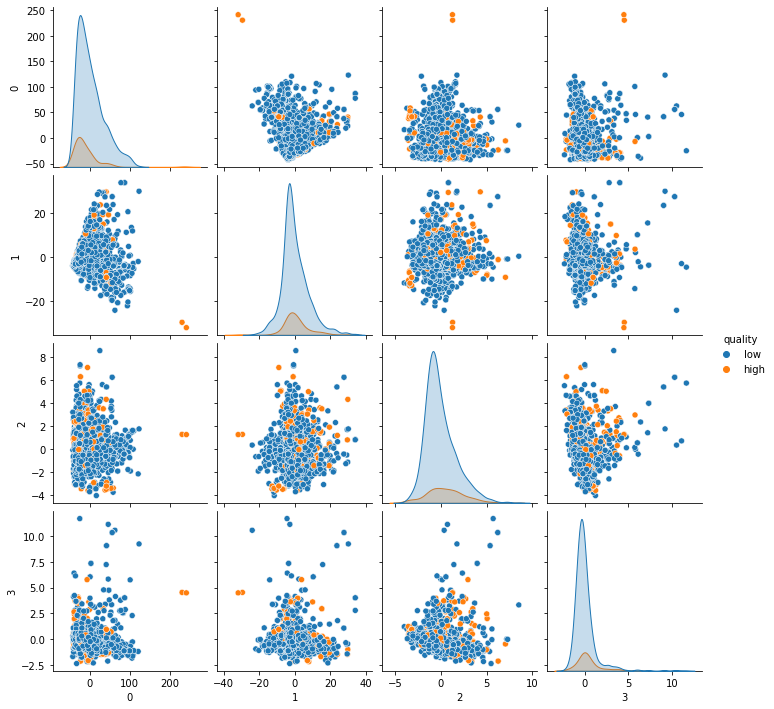

In [22]:
sns.pairplot(df.drop('c',axis=1), hue='quality')

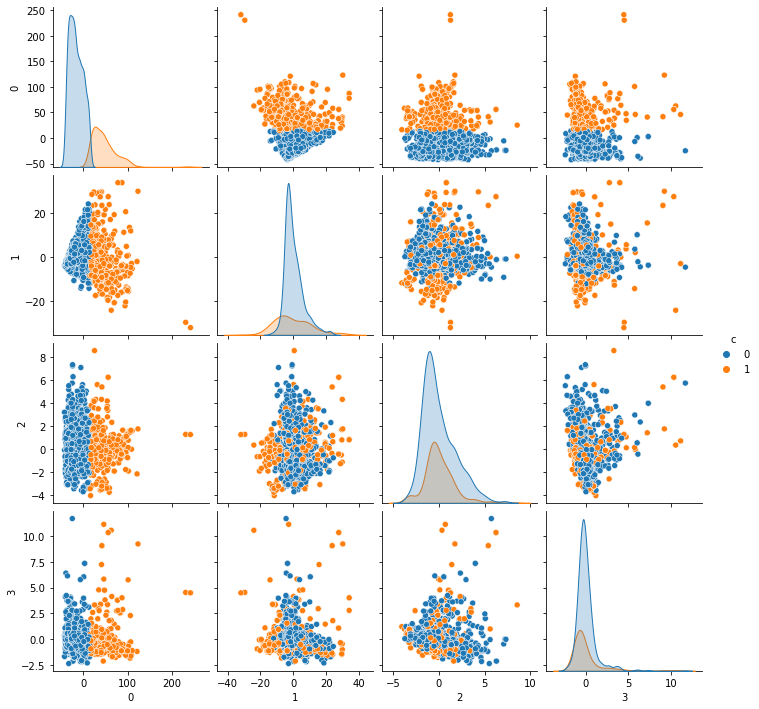

In [23]:
sns.pairplot(df.drop('quality',axis=1), hue='c')

In [24]:
c_pred = kmeans.labels_
c_true = (df['quality']=='high').astype(int).to_numpy()
conf = confusion_matrix(c_true, c_pred)
pd.DataFrame(conf, index=['truth: low','truth: high'])

,0,1
truth: low,985,397
truth: high,194,23


In [25]:
# Recall
# Proportion of data labeled high assigned cluster 1
conf[1,1]/(conf[1,0]+conf[1,1])

0.10599078341013825

In [26]:
# Specificity
# Proportion of data labeled low assigned cluster 0
conf[0,0]/(conf[0,0]+conf[0,1])

0.7127351664254703